In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path
from IPython.display import display
from tqdm import tqdm
import plotly.express as px
from sklearn import config_context

from lib_spotify_app.model import (
    dbcv,
    make_processing,
    make_optimization,
    make_default_optim_param_spaces,
    analysis_plot_pipe,
    enrich_data,
    get_output
)

from lib_spotify_app.api_adapter import (
    make_spotify_playlist,
    setup_spotipy,
    get_credential,
    query_liked_songs,
    get_playlist
)

%matplotlib inline
plt.rcParams['figure.figsize'] = (20, 10)
sns.set_context('notebook')
sns.set_style('whitegrid')

# Data Collection

In [3]:
scope=['user-library-read','user-top-read', 'playlist-modify-public', 'playlist-modify-private']

sp = setup_spotipy(
    Path(r'private/spotify_credential.json'),
    scope=scope,
    cache_path=Path(r'private/credential_spotipy')
)

In [4]:
playlist_list = [
    '37i9dQZF1DXca8AyWK6Y7g',
    '37i9dQZF1DWTBN71pVn2Ej',
    '37i9dQZF1DX9Mqxt6NLTDY',
    '37i9dQZF1DX3IplhwNexYg',
    '37i9dQZF1DX6ujZpAN0v9r',
    # '2HKu6hhXqMU6qbYhEWjPmt'
]

Either load multiples playlist or load the liked songs.

In [14]:
# df = query_liked_songs(sp)

In [21]:
df = pd.concat([get_playlist(sp, p) for p in playlist_list], ignore_index=True)

# Data Preparation

In [16]:
df = enrich_data(sp, df)
df = df.drop_duplicates(subset='track.id')

/home/sqrx/Python/spotify_app/.venv/lib/python3.8/site-packages/pandas/core/indexing.py:692: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value, self.name)


In [23]:
df.columns.to_list()

['index',
 'added_at',
 'is_local',
 'primary_color',
 'added_by.external_urls.spotify',
 'added_by.href',
 'added_by.id',
 'added_by.type',
 'added_by.uri',
 'track.album.album_type',
 'track.album.artists.0.external_urls.spotify',
 'track.album.artists.0.href',
 'track.album.artists.0.id',
 'track.album.artists.0.name',
 'track.album.artists.0.type',
 'track.album.artists.0.uri',
 'track.album.artists.1.external_urls.spotify',
 'track.album.artists.1.href',
 'track.album.artists.1.id',
 'track.album.artists.1.name',
 'track.album.artists.1.type',
 'track.album.artists.1.uri',
 'track.album.available_markets',
 'track.album.external_urls.spotify',
 'track.album.href',
 'track.album.id',
 'track.album.images.0.height',
 'track.album.images.0.url',
 'track.album.images.0.width',
 'track.album.images.1.height',
 'track.album.images.1.url',
 'track.album.images.1.width',
 'track.album.images.2.height',
 'track.album.images.2.url',
 'track.album.images.2.width',
 'track.album.name',
 'trac

In [26]:
from lib_spotify_app.enrich_artist_genre import EnrichArtistGenre

genre = EnrichArtistGenre(artists_id=df['track.artists.0.id'], sp=sp)

# Data Visualization

In [9]:
feat = [
    'track.id.danceability',
    'track.id.energy',
    'track.id.loudness',
    'track.id.speechiness',
    'track.id.acousticness',
    'track.id.instrumentalness',
    'track.id.liveness',
    'track.id.valence',
    'track.id.tempo',
]

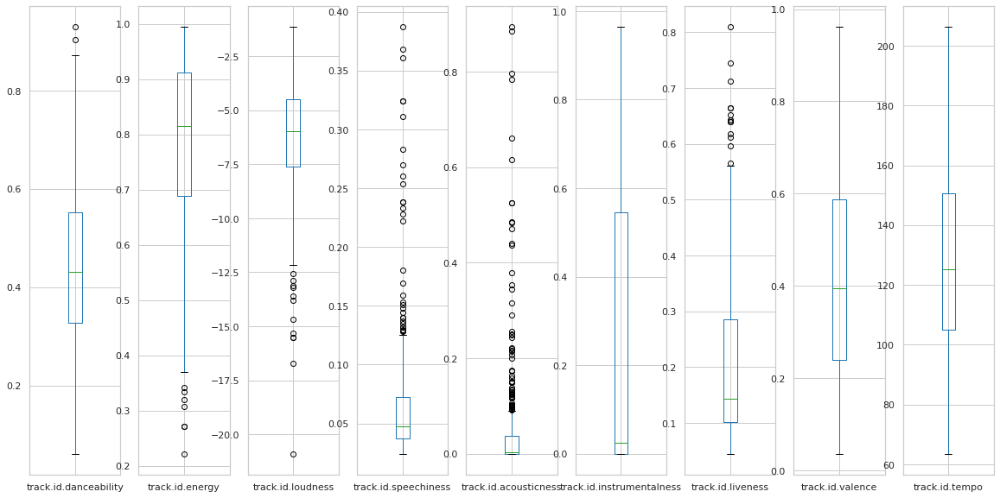

In [10]:
df[feat].plot(kind='box', subplots=True, sharex=False, sharey=False);

In [14]:
import hiplot as hip
displayed_exp = hip.Experiment.from_dataframe(df[feat]).display()

<IPython.core.display.Javascript object>

In [17]:
displayed_exp.get_selected()

GetSelectedFailure: No data received from the front-end. Please make sure that:
    1. You don't call "get_selected" on the same cell
    2. The interface has loaded
    3. You are in a Jupyter notebook (Jupyter lab is *not* supported)

# Modeling

In [10]:
n_iter = 100
n_best = 5

In [11]:
proc = make_processing(w_dist=True)

with config_context(display='diagram'):
    display(proc)

def get_optimal(df, n_iter=n_iter, scoring=dbcv):
    n_samples = np.max([df.shape[0]//8, 100])

    param_space = make_default_optim_param_spaces(n_samples, 'uniform')
    
    return make_optimization(
        proc,
        param_space,
        n_iter=n_iter,
        scoring=scoring,
        verbose=1,
        n_jobs=6
    ).fit(df)

Pipeline(steps=[('feature_selection',
                 FeatureSelector(columns=['track.id.danceability',
                                          'track.id.energy',
                                          'track.id.loudness',
                                          'track.id.speechiness',
                                          'track.id.acousticness',
                                          'track.id.instrumentalness',
                                          'track.id.liveness',
                                          'track.id.valence',
                                          'track.id.tempo'])),
                ('dist',
                 FunctionTransformer(func=<function make_processing.<locals>.<lambda> at 0x7f6315327160>)),
                ('mapper',
                 UMAP(metric='precomputed', n_epochs=200, random_state=42)),
                ('clusterer',
                 HDBSCAN(core_dist_n_jobs=1, gen_min_span_tree=True,
                         min_cluster_size=50))])

In [12]:
from lib_spotify_app.model import (
    dbcv_validity_score,
    abs_dbcv_validity_score,
    validity_score
)

optim = get_optimal(df)

Fitting 1 folds for each of 8 candidates, totalling 8 fits
[Parallel(n_jobs=6)]: Using backend LokyBackend with 6 concurrent workers.
[Parallel(n_jobs=6)]: Done   6 out of   8 | elapsed:   39.9s remaining:   13.3s
[Parallel(n_jobs=6)]: Done   8 out of   8 | elapsed:   48.4s finished
Fitting 1 folds for each of 8 candidates, totalling 8 fits
[Parallel(n_jobs=6)]: Using backend LokyBackend with 6 concurrent workers.
[Parallel(n_jobs=6)]: Done   6 out of   8 | elapsed:   25.6s remaining:    8.5s
[Parallel(n_jobs=6)]: Done   8 out of   8 | elapsed:   36.3s finished
Fitting 1 folds for each of 8 candidates, totalling 8 fits
[Parallel(n_jobs=6)]: Using backend LokyBackend with 6 concurrent workers.
[Parallel(n_jobs=6)]: Done   6 out of   8 | elapsed:   16.3s remaining:    5.4s
[Parallel(n_jobs=6)]: Done   8 out of   8 | elapsed:   21.4s finished
Fitting 1 folds for each of 8 candidates, totalling 8 fits
[Parallel(n_jobs=6)]: Using backend LokyBackend with 6 concurrent workers.
[Parallel(n_jo

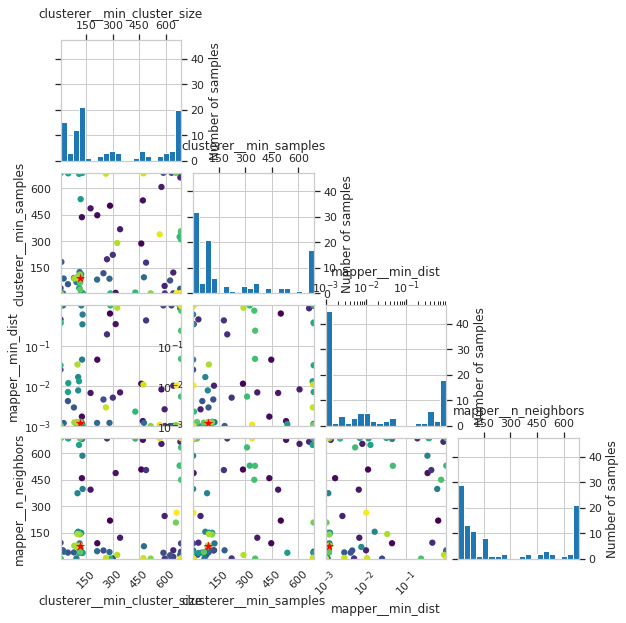

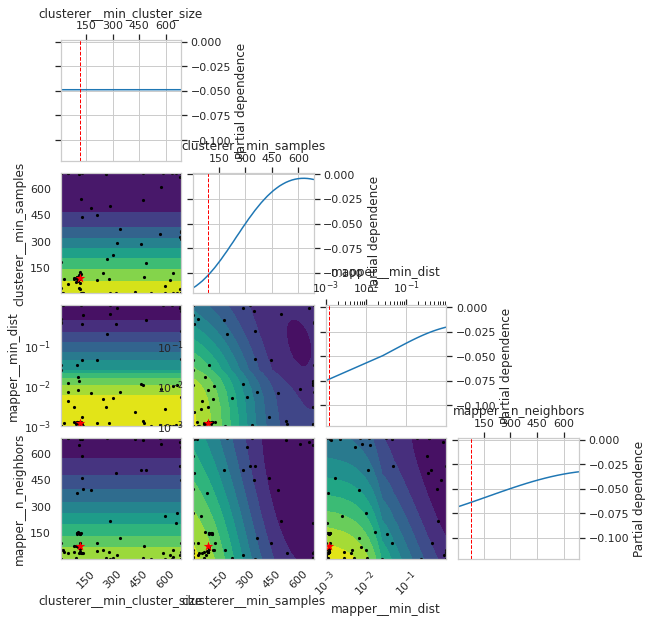

In [16]:
from skopt.plots import plot_evaluations, plot_objective

plot_evaluations(optim.optimizer_results_[0]);
plot_objective(optim.optimizer_results_[0]);

# Modeling Results

([{'clusterer__min_cluster_size': 115,
   'clusterer__min_samples': 91,
   'mapper__min_dist': 0.001216593205695054,
   'mapper__n_neighbors': 79},
  {'clusterer__min_cluster_size': 118,
   'clusterer__min_samples': 87,
   'mapper__min_dist': 0.001193858888371338,
   'mapper__n_neighbors': 40},
  {'clusterer__min_cluster_size': 104,
   'clusterer__min_samples': 90,
   'mapper__min_dist': 0.0012066209632330528,
   'mapper__n_neighbors': 76},
  {'clusterer__min_cluster_size': 117,
   'clusterer__min_samples': 112,
   'mapper__min_dist': 0.0012392920237545132,
   'mapper__n_neighbors': 145},
  {'clusterer__min_cluster_size': 643,
   'clusterer__min_samples': 5,
   'mapper__min_dist': 0.001,
   'mapper__n_neighbors': 15}],
 <Figure size 864x2880 with 10 Axes>)

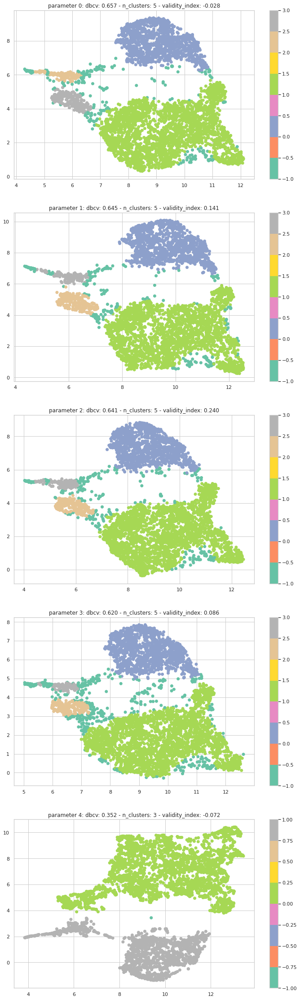

In [17]:
analysis_plot_pipe(optim, df, n_best=n_best)

In [18]:
# best_params =   {'clusterer__min_cluster_size': 11,
#    'clusterer__min_samples': 14,
#    'mapper__min_dist': 0.001188494742794067,
#    'mapper__n_neighbors': 5}

In [19]:
best_params = dict(optim.best_params_)

In [20]:
best_proc = proc.set_params(**best_params).fit(df)

with config_context(display='diagram'):
    display(best_proc)

Pipeline(steps=[('feature_selection',
                 FeatureSelector(columns=['track.id.danceability',
                                          'track.id.energy',
                                          'track.id.loudness',
                                          'track.id.speechiness',
                                          'track.id.acousticness',
                                          'track.id.instrumentalness',
                                          'track.id.liveness',
                                          'track.id.valence',
                                          'track.id.tempo'])),
                ('dist',
                 FunctionTransformer(func=<function make_processing.<locals>.<lambda> at 0x7f6315327160>)),
                ('mapper',
                 UMAP(metric='precomputed', min_dist=0.001216593205695054,
                      n_epochs=200, n_neighbors=79, random_state=42)),
                ('clusterer',
                 HDBSCAN(core_dist_n_jobs=1, gen_min_span_tree=True,
                         min_cluster_size=115, min_samples=91))])

In [21]:
dfplot = pd.concat(
    [df.reset_index(drop=True), get_output(best_proc, df)],
    axis=1
)

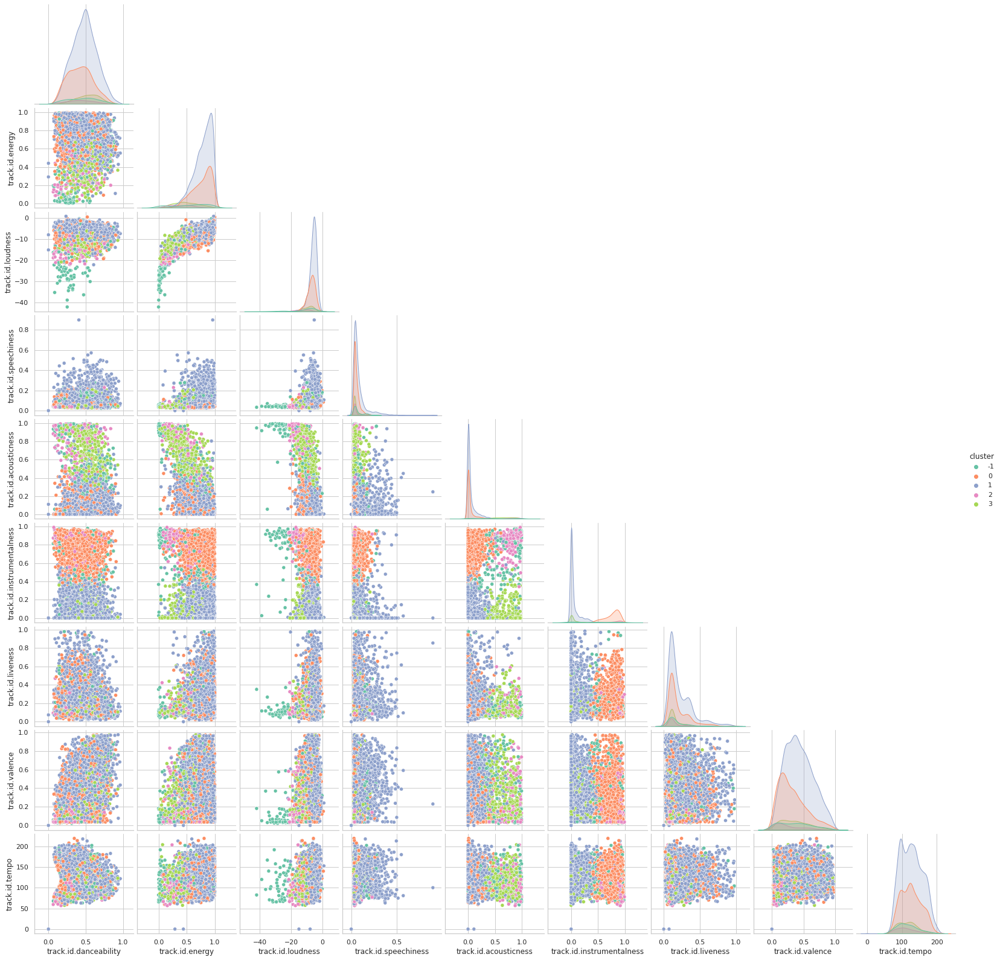

In [48]:
sns.pairplot(
    data=dfplot[feat+['cluster']],
    hue='cluster',
    corner=True,
    palette=sns.color_palette("Set2", dfplot['cluster'].unique().shape[0]),
)

# Deployement

In [23]:
# count of most popular songs to analyse
top_n = 20

In [24]:
dfplot['hover_text'] = dfplot.apply(
    lambda x:
        f'<br>'+
        f'Full Song: <a href="{x["track.external_urls.spotify"]}">Play</a><br>' +
        f'Album: {x["track.album.name"]}<br>' +
        # f'Genres: {x["artists.genres"]}<br>'+
        # f'Super Genres: {x["artists.supergenres"]}<br>' +
        f'Super Genre 1: {x["artists.supergenre_1"]}<br>',
    axis=1
)

dfplot['fullname'] = dfplot.apply(
    lambda x: f'{x["track.name"]}, {x["track.artists.0.name"]}<br>',
    axis=1
)

dfplot['size'] = dfplot['track.popularity'].apply(lambda x: np.log(x+1))

In [41]:
col = [
    'cluster',
    'xmap',
    'ymap',
    'hover_text',
    'fullname',
    'size',
    'track.preview_url',
    'track.popularity',
    'track.external_urls.spotify',
    'artists.supergenre_1',
    'artists.genres',
]

df_top = dfplot[col].groupby('cluster', as_index=False).apply(
    lambda x: x.sort_values('track.popularity', ascending=False).head(top_n)
)

In [42]:
from plotly.offline import download_plotlyjs, init_notebook_mode
import plotly.express as px
init_notebook_mode(connected=True)

fig = px.scatter(
    df_top,
    x='xmap',
    y='ymap',
    hover_name='fullname',
    hover_data=['hover_text'],
    text=df_top['track.preview_url'].map(lambda x: f'<a href="{x}">Play</a>'),
    size='size',
    color=df_top['cluster'].astype(str),
    color_discrete_sequence=px.colors.qualitative.Vivid,
    title=f'my top {top_n} songs per cluster'
)

fig.update_layout(
    autosize=False,
    width=1000,
    height=800,
)

In [45]:
n_show = 5

df_top.groupby('cluster').apply(
    lambda x: x[[
        'fullname',
        'track.popularity',
        'track.external_urls.spotify',
        'artists.supergenre_1',
        'artists.genres'
        ]].head(n_show)
).style.bar()